In [1]:
import numpy as np  

import sys
sys.path.append("..")

import anndata
import cellpath as cp
import cellpath.visual as visual
import cellpath.benchmark as bmk 
import cellpath.de_analy as de

In [2]:
import scvelo as scv
import pandas as pd
import matplotlib.pyplot as plt
import cellrank as cr

from sklearn.cluster import KMeans
import scprep
import pandas as pd
import matplotlib.pyplot as plt

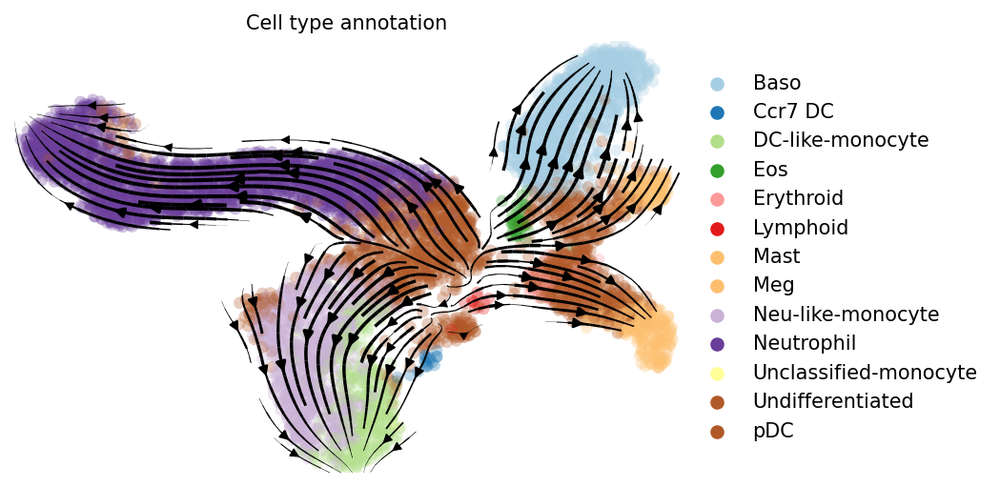

In [4]:
adata = anndata.read_h5ad("../data/real/hema/adata_day4_scvelo.h5ad")
adata.obs["clusters"] = adata.obs["Cell type annotation"]
scv.pl.velocity_embedding_stream(adata, color = "Cell type annotation", dpi = 150, palette = "Paired", legend_loc = "right margin", save = None, basis = "umap")

In [9]:
num_trajs = 20
# # not pre-clustered
# adata = anndata.read_h5ad("../data/real/hema/adata_day4_scvelo.h5ad")
# adata.obsm["X_spring"] = adata.obs.loc[:,["SPRING-x", "SPRING-y"]].values
# adata.obs.rename(columns={'Cell type annotation':'clusters'}, inplace=True)

adata = anndata.read_h5ad("../data/real/hema/adata_day4_clust.h5ad")

cellpath_obj = cp.CellPath(adata = adata, preprocess = True)

cellpath_obj.meta_cell_construction(flavor = "leiden", n_clusters = 550, resolution = 50, include_unspliced = True, standardize = True, seed = 0)
cellpath_obj.meta_cell_graph(k_neighs = 20, pruning = True)
cellpath_obj.meta_paths_finding(threshold = 0.85, cutoff_length = 5, length_bias = 0.5)
cellpath_obj.first_order_pt(num_trajs = num_trajs, prop_insert = 0.0)

Already conducted clustering
Meta-cell constructed, number of meta-cells: 408
Meta-cell level neighborhood graph constructed
conduct quality control
selected path (starting_ending):
start_end:  141_94 , len:  14 newly covered: 14
start_end:  58_105 , len:  13 newly covered: 13
start_end:  95_313 , len:  13 newly covered: 13
start_end:  361_16 , len:  12 newly covered: 12
start_end:  96_71 , len:  11 newly covered: 11
start_end:  107_105 , len:  12 newly covered: 10
start_end:  206_198 , len:  11 newly covered: 10
start_end:  93_202 , len:  10 newly covered: 10
start_end:  141_22 , len:  14 newly covered: 8
start_end:  168_75 , len:  9 newly covered: 9
start_end:  107_355 , len:  12 newly covered: 7
start_end:  107_64 , len:  10 newly covered: 8
start_end:  123_29 , len:  11 newly covered: 7
start_end:  141_19 , len:  13 newly covered: 6
start_end:  206_64 , len:  9 newly covered: 7
start_end:  374_80 , len:  7 newly covered: 7
start_end:  168_29 , len:  8 newly covered: 6
start_end:  3

In [10]:
def plot_data(cellpath_obj, basis = "umap", figsize = (15,7), save_as = None, title = None, **kwargs):
    """\
    Description
        Plot original dataset
    
    Parameters
    ----------
    cellpath_obj
        cellpath object
    basis
        the basis used for visualization
    figsize
        Figure size, tuple
    save_as
        Name of the saved file
    """

    _kwargs = {
        "axis": False,
        "legend_pos": "upper left",
        "colormap": "tab20",
        "s": 10,
        "add_arrow": False
    }
    _kwargs.update(kwargs)

    X = cellpath_obj.adata.obsm["X_" + basis]
    fig = plt.figure(figsize = figsize)
    ax = fig.add_subplot()
    if _kwargs["axis"]:
        ax.tick_params(axis = "both", direction = "out", labelsize = 16)
        ax.set_xlabel(basis + " 1", fontsize = 19)
        ax.set_ylabel(basis + " 2", fontsize = 19)
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)
    else:
        ax.axis("off")

    if "clusters" in cellpath_obj.adata.obs.columns:
        cluster_anno = [x for x in cellpath_obj.adata.obs["clusters"].values]
        cluster_uni = [x for x in np.unique(cellpath_obj.adata.obs["clusters"].values)]
        print(len(cluster_uni))

        colormap = plt.cm.get_cmap(_kwargs["colormap"], len(cluster_uni) + 3)

        for count, clust in enumerate(cluster_uni):
            idx = np.where(np.array(cluster_anno) == clust)[0]
            ax.scatter(X[idx,0], X[idx,1], color = colormap(count), alpha = 0.7, label = clust, s = _kwargs["s"])    
        ax.legend(loc=_kwargs["legend_pos"], prop={'size': 15}, frameon = False, ncol = 1,bbox_to_anchor=(1.05, 1), markerscale=5.)
    
    elif "sim_time" in cellpath_obj.adata.obs.columns:
        X_ordered = X[np.argsort(cellpath_obj.adata.obs["sim_time"].values),:]
        if _kwargs["add_arrow"]:
            for i in range(X_ordered.shape[0]-1):
                line = ax.plot(X_ordered[i:(i+2), 0], X_ordered[i:(i+2), 1], 'gray', '-', alpha = 1)
                add_arrow(line[0], size = 5)

        pic = ax.scatter(X_ordered[:,0], X_ordered[:,1], cmap = "gnuplot", c = np.arange(X_ordered.shape[0]), alpha = 1, s = _kwargs["s"])
        cbar = fig.colorbar(pic, fraction=0.046, pad=0.04, ax = ax)
        cbar.ax.tick_params(labelsize = 20)
        

    else:
        ax.scatter(X[:,0], X[:,1], color = "red", alpha = 0.7, s = _kwargs["s"])

    if title is not None:
        ax.set_title(title, fontsize = 25)
    if save_as != None:
        fig.savefig(save_as, bbox_inches = 'tight')

13


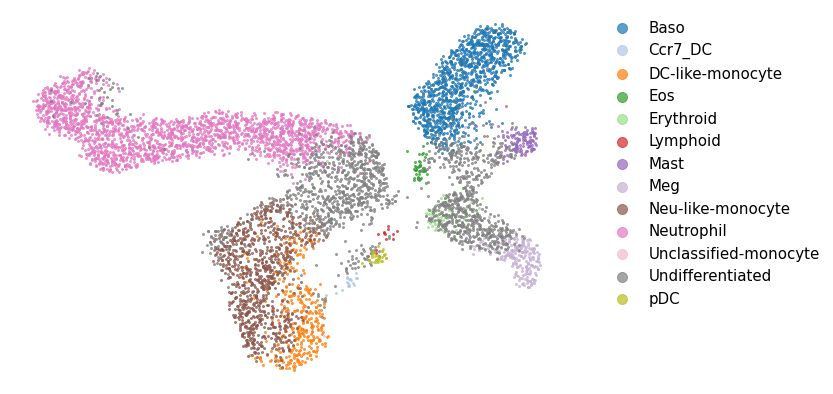

In [11]:
plot_data(cellpath_obj = cellpath_obj, basis = "umap", figsize = (10,7), save_as = None, legend_pos = "upper left", colormap = "tab20", s =4)

In [12]:

def add_arrow(line, position = None, direction='right', **kwargs):
    """
    add an arrow to a line.

    line:       Line2D object
    position:   x-position of the arrow. If None, mean of xdata is taken
    direction:  'left' or 'right'
    arrow_size:       size of the arrow in fontsize points
    color:      if None, line color is taken.
    """
    _kwargs = {
        "arrow_size": 15,
        "linewidth": 2,
        "alpha": 0.7,
        "color": None,
        "arrow_style": "->"
    }
    _kwargs.update(kwargs)

    if _kwargs["color"] is None:
        color = line.get_color()
    else:
        color = _kwargs["color"]

    xdata = line.get_xdata()
    ydata = line.get_ydata()

    if position is None:
        position = xdata.mean()
    # find closest index
    
    if direction == 'right':
        start_ind = 0
        end_ind = 1
    else:
        end_ind = 0
        start_ind = 1

    line.axes.annotate('',
        xytext=(xdata[start_ind], ydata[start_ind]),
        xy=(xdata[end_ind], ydata[end_ind]),
        arrowprops=dict(arrowstyle = _kwargs["arrow_style"], color=color, linewidth = _kwargs["linewidth"], alpha = _kwargs["alpha"]),
        size=_kwargs["arrow_size"]
    )


def meta_traj_visual(cellpath_obj, basis = "pca", trajs = 4, 
                     figsize = (20,10), save_as = None, title = None, **kwargs):
    """\
    Description        
        Meta-cell-level trajectory visualization

    Parameters
    ----------
    cellpath_obj
        Cellpath object
    basis
        the basis used for visualization
    trajs
        The number of trajectories plotted, note that trajs cannot be too much, or there may exists trajs contains too few cells, may even less than the neighs parameter
    figsize
        Figure size, tuple
    save_as
        Name of the saved file
    title
        The title name of the plot
    """
    _kwargs = {
        "arrow_size": 30,
        "linewidth": 3,
        "alpha": 1,
        "color": None,
        "arrow_style": "->",
        "legend_pos": "upper right", 
        "axis": False,
        "colormap": "tab20b"    
    }

    _kwargs.update(kwargs)

    fig = plt.figure(figsize = figsize)
    ax = fig.add_subplot()

    if _kwargs["axis"]:
        ax.tick_params(axis = "both", direction = "out", labelsize = 16)
        ax.set_xlabel(basis + " 1", fontsize = 19)
        ax.set_ylabel(basis + " 2", fontsize = 19)
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)
    else:
        ax.axis('off')

    # get cmap
    colormap = plt.cm.get_cmap(_kwargs["colormap"], trajs)

    # path_color = get_cmap(trajs, 'tab20b')
    if "X_" + basis not in cellpath_obj.adata.obsm:
        raise ValueError("please calculate " + basis + " first")
    else:
        X_cell = cellpath_obj.adata.obsm["X_"+basis].copy()
        groups = cellpath_obj.groups
        X_clust = np.zeros((int(np.max(groups) + 1), X_cell.shape[1]))
        for c in np.unique(groups):
            indices = np.where(groups == c)[0]
            X_clust[c,:] = np.mean(X_cell[indices,:], axis = 0)

    # draw clusters 
    ax.scatter(X_clust[0:-1:1,0], X_clust[0:-1:1,1], color = 'gray', alpha = 0.5)

    # draw meta-cell trajectories
    for i in range(20):
        start_point = True
        for index in cellpath_obj.paths[cellpath_obj.greedy_order[i]]:
            if start_point:
                coord_pri = X_clust[index,0:2]
                start_point = False
            else:
                coord_pri = coord_x.copy()
            # new coord
            coord_x = X_clust[index,0:2]
            line = plt.plot([coord_pri[0],coord_x[0]],[coord_pri[1],coord_x[1]],'o-', 
                            linewidth = _kwargs["linewidth"], color = colormap(i), alpha = _kwargs["alpha"])
            add_arrow(line[0], **_kwargs)

        line[0].set_label('Path '+str(i))
        plt.legend(loc = _kwargs["legend_pos"], prop = {'size': 20}, frameon = False, ncol = 1)

    if title != None:
        plt.title(title)
    if save_as!= None:
        fig.savefig(save_as, bbox_inches = 'tight')



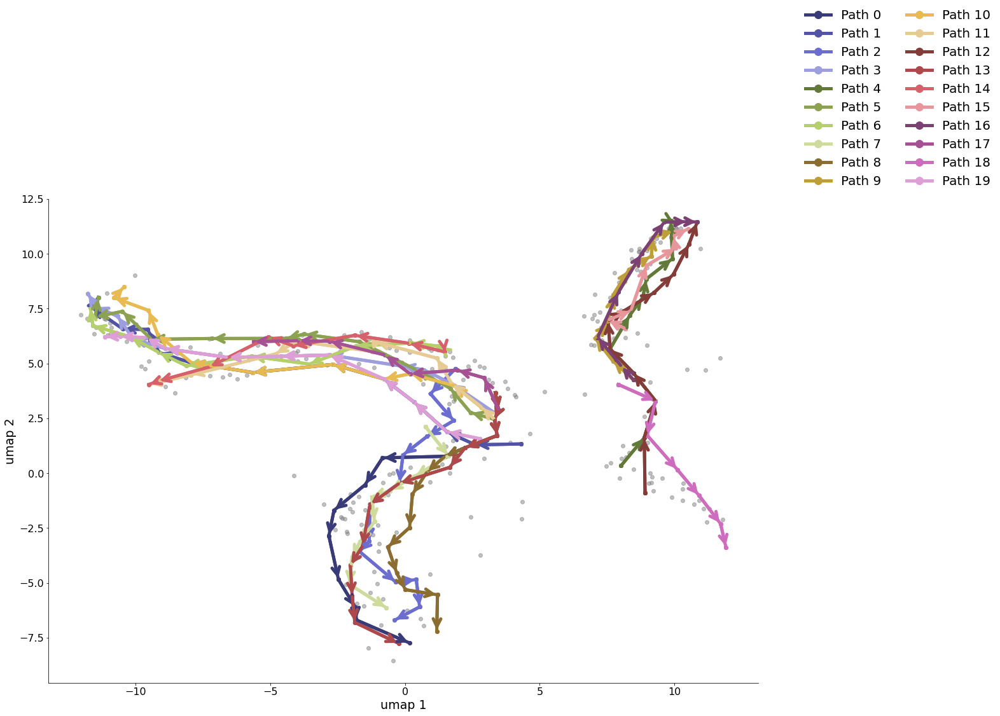

In [14]:
visual.meta_traj_visual(cellpath_obj, basis="umap", trajs = 20, axis = True, figsize = (20,14), legend_pos = "lower left", save_as = None, markerscale = 2, linewidth = 5)

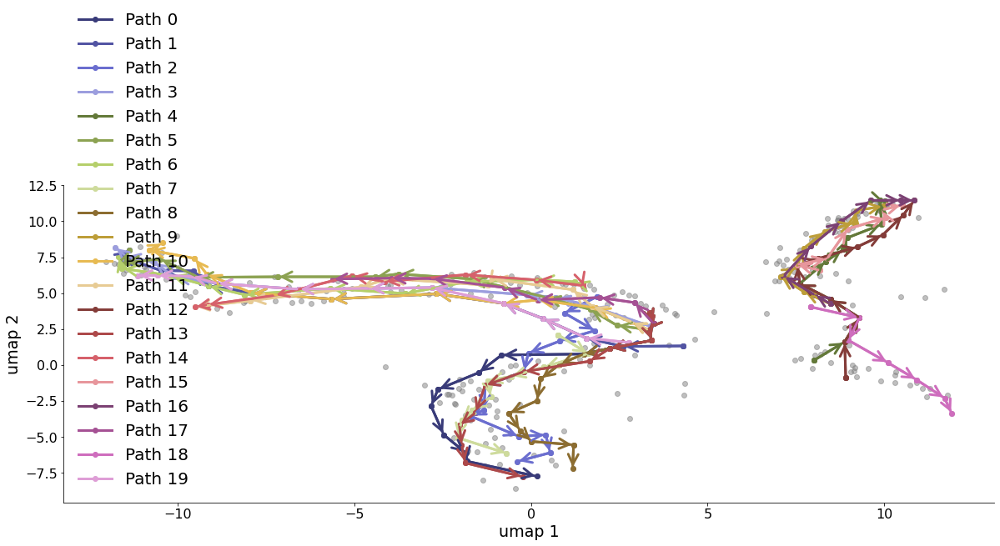

In [15]:
meta_traj_visual(cellpath_obj, basis="umap", trajs = 20, axis = True, figsize = (20,7), legend_pos = "lower left", save_as = None)

In [620]:
import importlib 
importlib.reload(visual)

<module 'cellpath.visual' from '../cellpath/visual.py'>

In [660]:
idx = np.where(~np.isnan(cellpath_obj.pseudo_order["traj_0"].values))[0]
barcode_6 = cellpath_obj.pseudo_order.iloc[idx,0].index.values
types, comp = np.unique(adata.obs.loc[barcode_6, "clusters"].values, return_counts = True)

In [661]:
comp/np.sum(comp)

array([0.0703125, 0.453125 , 0.015625 , 0.4609375])

In [646]:
idx = np.where(~np.isnan(cellpath_obj.pseudo_order["traj_8"].values))[0]
barcode_6 = cellpath_obj.pseudo_order.iloc[idx,8].index.values
types, comp = np.unique(adata.obs.loc[barcode_6, "clusters"].values, return_counts = True)

In [648]:
types

array(['DC-like-monocyte', 'Neu-like-monocyte', 'Neutrophil',
       'Unclassified-monocyte', 'Undifferentiated'], dtype=object)

In [647]:
comp/np.sum(comp)

array([0.3514644351, 0.1548117155, 0.0167364017, 0.0041841004,
       0.4728033473])

In [654]:
import matplotlib as mpl

In [690]:
mpl.rcParams['font.size'] = 20.0

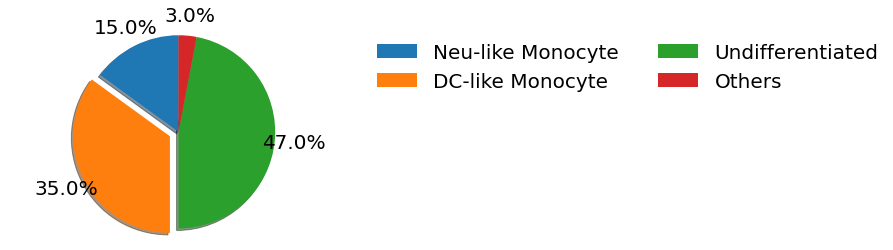

In [695]:

# Pie chart, where the slices will be ordered and plotted counter-clockwise:
labels = ['Neu-like Monocyte', 'DC-like Monocyte', 'Undifferentiated', 'Others']
sizes = [15, 35, 47, 3]
explode = (0.0, 0.1, 0, 0)  # only "explode" the 2nd slice (i.e. 'Hogs')

fig1, ax1 = plt.subplots()
ax1.pie(sizes, explode=explode, autopct='%1.1f%%', shadow=True, startangle=90, pctdistance=1.2, labeldistance=1.2)
ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
ax1.legend(labels, loc = "upper left", prop = {'size': 20}, frameon = False, ncol = 2, bbox_to_anchor=(1.05, 1))
fig1.savefig("path_8_pie.png")

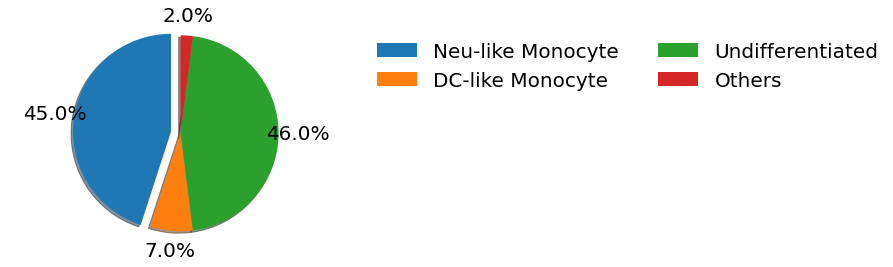

In [692]:

# Pie chart, where the slices will be ordered and plotted counter-clockwise:
labels = ['Neu-like Monocyte', 'DC-like Monocyte', 'Undifferentiated', 'Others']
sizes = [45, 7, 46, 2]
explode = (0.1, 0.0, 0, 0)  # only "explode" the 2nd slice (i.e. 'Hogs')

fig1, ax1 = plt.subplots()
ax1.pie(sizes, explode=explode, autopct='%1.1f%%', shadow=True, startangle=90, pctdistance=1.2, labeldistance=1.2)
ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
ax1.legend(labels, loc = "upper left", prop = {'size': 20}, frameon = False, ncol = 2, bbox_to_anchor=(1.05, 1))
fig1.savefig("path_0_pie.png")

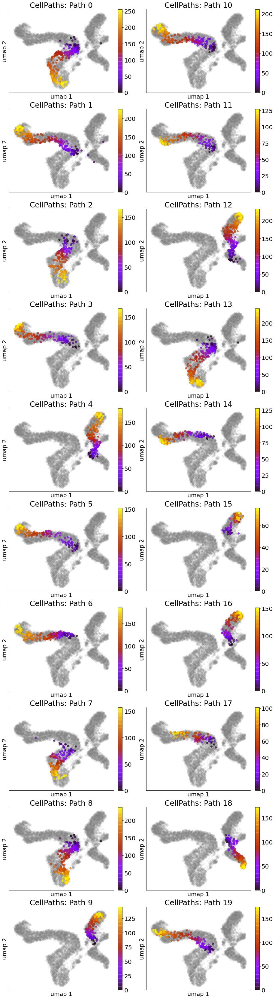

In [270]:
visual.first_order_approx_pt(cellpath_obj, basis="umap", trajs = num_trajs, figsize=(15,60), save_as= None)

In [243]:
idx = np.where(~np.isnan(cellpath_obj.pseudo_order["traj_5"].values))[0]
barcode_6 = cellpath_obj.pseudo_order.iloc[idx,5].index.values
idx = np.where(~np.isnan(cellpath_obj.pseudo_order["traj_2"].values))[0]
barcode_2 = cellpath_obj.pseudo_order.iloc[idx,2].index.values
idx = np.where(~np.isnan(cellpath_obj.pseudo_order["traj_0"].values))[0]
barcode_0 = cellpath_obj.pseudo_order.iloc[idx,0].index.values


In [244]:
np.unique(adata.obs.loc[barcode_6, "clusters"].values, return_counts = True)

(array(['Neutrophil', 'Undifferentiated'], dtype=object), array([111,  25]))

In [245]:
np.unique(adata.obs.loc[barcode_2, "clusters"].values, return_counts = True)

(array(['DC-like-monocyte', 'Neu-like-monocyte', 'Neutrophil',
        'Undifferentiated'], dtype=object),
 array([82, 73,  6, 52]))

In [246]:
np.unique(adata.obs.loc[barcode_0, "clusters"].values, return_counts = True)

(array(['Neutrophil', 'Undifferentiated'], dtype=object), array([145,  50]))

In [15]:
from sklearn.metrics import pairwise_distances
from sklearn.neighbors import NearestNeighbors


def NeighborhoodGraph(X, k_neighs, symm = True, pruning = True):
    # construct obj with sklearn, metric eculidean
    neighbor = NearestNeighbors(n_neighbors=k_neighs)
    # training state [n_samples(cells),n_features(genes)]
    neighbor.fit(X)
    # get test connectivity result 0-1 adj_matrix, mode = 'connectivity' by default
    adj_matrix = neighbor.kneighbors_graph(X).toarray()
    if symm:
        if pruning:
            adj_matrix *= adj_matrix.T
        else:
            adj_matrix += adj_matrix.T
        # change 2 back to 1
        adj_matrix = np.where(adj_matrix != 0, 1.0, 0.0)
        dist_matrix = pairwise_distances(X, metric = "euclidean")

    return adj_matrix, dist_matrix


def assign_weights(connectivities, distances, X, velo_pca, scaling = 3, distance_scalar = 0.5, threshold = 0):

    cosine_sim = (-np.sum(X * velo_pca, axis = 1)[:, None] + np.matmul(velo_pca, X.T))/(1e-12 + distances * np.linalg.norm(velo_pca, 2, axis = 1)[:,None])
    # assert np.sum(np.isnan(cosine_sim)) == 0
    # cosine_sim = np.nan_to_num(cosine_sim, copy = True, nan = 0.0)
    # cosine_sim = (cosine_sim > threshold) * cosine_sim #(cosine_sim <= threshold) * np.inf
    
    np.fill_diagonal(cosine_sim, val = 1)
    
    assert np.min(connectivities * (1-cosine_sim)) >= 0
    # assert np.max(connectivities * (1-cosine_sim)) <= 1

    adj_matrix = connectivities * (1 - cosine_sim) + distance_scalar * connectivities * distances/np.max(1e-12 + connectivities * distances, axis = 1)[:,None]
    adj_matrix = np.where((adj_matrix == 0)|(cosine_sim <= threshold), np.inf, adj_matrix)
    adj_matrix = (scaling * adj_matrix) ** scaling
    
    np.fill_diagonal(adj_matrix, val = 0)
    
    return adj_matrix


def assign_weights2(connectivities, distances, X, velo_pca, scaling = 3, distance_scalar = 0.5, threshold = 0):

    adj_matrix = np.zeros_like(connectivities)
    cells = adj_matrix.shape[0]
    distances = connectivities * distances
    # the resulted adj_matrix is quite sparse
    for i in range(cells):
        # the maximal distance between i and its neighbors
        dmax = np.max(distances[i,:])
        for j in range(cells):
            # cell i to cell j: 
            # if not zero, which means there's an connnection, notice the diagonal value is also one
            if connectivities[i,j] != 0 and i != j:
                # expression data for cell i
                express_i = X[i,:]
                # expression data for cell j
                express_j = X[j,:]
                # expression error
                velo_i = velo_pca[i,:]
                # cos_theta = np.matmul((express_j - express_i),velo_i)/(1e-12 + np.linalg.norm(express_j - express_i,2) * np.linalg.norm(velo_i,2))
                cos_theta = np.matmul((express_j - express_i),velo_i)/(1e-12 + distances[i,j] * np.linalg.norm(velo_i,2))
                
                
                if cos_theta > threshold:
                    # distance penalty in [0,1]
                    # ld = np.linalg.norm(express_j-express_i,2)/dmax
                    ld = distances[i,j]/dmax
                    assert np.abs(np.linalg.norm(express_j-express_i,2) - distances[i,j]) < 1e-4
                    # direction penalty in [0,1]
                    ltheta = 1-cos_theta
                    # distance penalty and angular penalty, distance penalty is important for knn on sparse graph(around 500 nodes), product is not good for small angular but large distance
                    adj_matrix[i,j] = (scaling * (ltheta + distance_scalar * ld)) ** scaling
                
                else:
                    adj_matrix[i,j] = np.inf
            # same node can also have 0
            elif i == j:
                adj_matrix[i,j] = 0
            # disconnected nodes, assign it to infinity
            else:    
                adj_matrix[i,j] = np.inf
    
    
    return adj_matrix

adj_matrix, dist_matrix = NeighborhoodGraph(cellpath_obj.X_clust, k_neighs = 10, symm = True, pruning = True)
adj1 = assign_weights(adj_matrix, dist_matrix, cellpath_obj.X_clust, cellpath_obj.velo_clust, scaling = 3, distance_scalar = 0.5, threshold = 0)
adj_matrix, dist_matrix = NeighborhoodGraph(cellpath_obj.X_clust, k_neighs = 10, symm = True, pruning = True)
adj2 = assign_weights2(adj_matrix, dist_matrix, cellpath_obj.X_clust, cellpath_obj.velo_clust, scaling = 3, distance_scalar = 0.5, threshold = 0)
np.sum(np.where(adj2 == np.inf, 0, adj2) - np.where(adj1 == np.inf, 0, adj1))

In [217]:
adata

AnnData object with n_obs × n_vars = 6555 × 3000
    obs: 'Library', 'Cell barcode', 'Time point', 'Starting population', 'clusters', 'Well', 'SPRING-x', 'SPRING-y', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'groups'
    var: 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'velocity_gamma', 'velocity_r2', 'velocity_genes'
    uns: 'Cell type annotation_colors', 'neighbors', 'pca', 'umap', 'velocity_graph', 'velocity_graph_neg', 'velocity_params'
    obsm: 'X_pca', 'X_phate', 'X_pre_pca', 'X_spring', 'X_umap', 'velocity_pca', 'velocity_umap'
    varm: 'PCs'
    layers: 'Ms', 'Mu', 'spliced', 'unspliced', 'variance_velocity', 'velocity'
    obsp: 'connectivities', 'distances'

In [629]:
adata = anndata.read_h5ad("../real_data/hema/adata_day4_scvelo.h5ad")
X_pca = adata.obsm["X_pca"]
X_umap = adata.obsm["X_umap"]

In [630]:
n_clusters = 10
init = "k-means++"
n_init = 10
max_iter = 300
tol = 0.0001
kmeans = KMeans(n_clusters, init, n_init, max_iter, tol)
groups = kmeans.fit_predict(X_pca)
meta_data = adata.obs
meta_data['groups'] = groups

Text(0.5, 1.0, 'slingshot clusters')

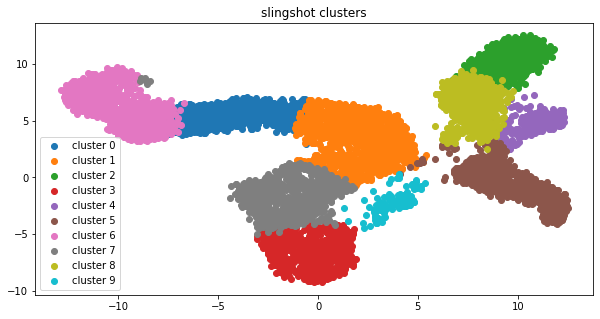

In [631]:
fig = plt.figure(figsize = (10,5))
ax = fig.add_subplot()
# c_range = [eval(x) if isinstance(x, str) else x for x in adata.obs['sim_time']]
clusters = int(np.max(groups)+1)
for i in range(clusters):
    sub_cells = np.where(groups == i)[0]
    progression = ax.scatter(X_umap[sub_cells,0], X_umap[sub_cells,1], cmap = plt.get_cmap('Pastel1'))
    # progression = ax.scatter(X_umap[sub_cells,0], X_umap[sub_cells,1], cmap = plt.get_cmap('Pastel1'))

ax.legend(['cluster '+ str(i) for i in range(clusters)])
ax.set_title("slingshot clusters")
# fig.savefig("./syn_results/dataset1/slingshot_clust.pdf")

In [632]:
X_pca_df = pd.DataFrame(index=[str(x) for x in range(X_pca.shape[0])], columns= np.arange(2), data = X_pca[:,0:2])
# scprep.run.install_bioconductor('slingshot')
results = scprep.run.Slingshot(X_pca_df, meta_data['groups'], start_cluster = 1)

In [636]:

def slingshot_visual(adata, results, basis = "umap", figsize = (20,10), save_as = None, title = None, axis = True):
    """\
    Description        
        Infer pseudo-time using Slingshot, and return kendall-tau coefficient as accuracy value

    Parameters
    ----------
    adata
        AnnData
    results
        Slingshot result
    basis
        the basis used for visualization
    figsize
        Figure size, tuple
    save_as
        Name of the saved file
    title
        The title name of the plot
    axis
        Show axis or not, boolean value

    Return
    ----------
    kt
        Kendall-tau coefficient          
    """
    if "X_" + basis not in adata.obsm:
        raise ValueError("please calculate " + basis + " first")
    else:
        X = adata.obsm['X_' + basis]

    trajs = results['pseudotime'].shape[1]
    nrows = np.ceil(trajs).astype('int32')
    ncols = 1
    fig, axs = plt.subplots(nrows = nrows, ncols = ncols, figsize = figsize)
    if title:
        fig.suptitle("Slingshot pseudo-time", fontsize = 18)

    kt = {}

    for i in range(trajs):
        if nrows == 1 or ncols == 1:
            if nrows == 1 and ncols == 1:
                ax = axs
            else:
                ax = axs[i]
        else:
            ax = axs[i%nrows, i//nrows]

        ax.scatter(X[:,0],X[:,1], color = 'gray', alpha = 0.1)
        # ax.plot(results['curves'][i,:,0],results['curves'][i,:,1],color = 'black', linewidth = 4)

        # kendall-tau
        pt_i = results['pseudotime'].iloc[:,i]
        pt_index = [x for x in pt_i.index if not np.isnan(pt_i[x])]
        ordering = [eval(x) for x in pt_i[pt_index].sort_values().index]
        pt_i = pt_i[pt_index]
        # true_i = adata.obs['sim_time'].iloc[pt_index].values
        # kt["traj_"+str(i)] = bmk.kendalltau(pt_i, true_i)

        X_traj = X[ordering,:]

        pseudo_visual = ax.scatter(X_traj[:,0],X_traj[:,1],c = np.arange(X_traj.shape[0]), cmap=plt.get_cmap('gnuplot'),alpha = 0.7)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_xlabel(basis + " 1", fontsize = 19)
        ax.set_ylabel(basis + " 2", fontsize = 19)

        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)

        cbar = fig.colorbar(pseudo_visual,fraction=0.046, pad=0.04, ax = ax)
        cbar.ax.tick_params(labelsize = 20)
        ax.set_title("Slingshot: Path " + str(i), fontsize = 25)

    if save_as != None:
        fig.savefig(save_as,bbox_inches = 'tight')
    plt.show()    
    return kt



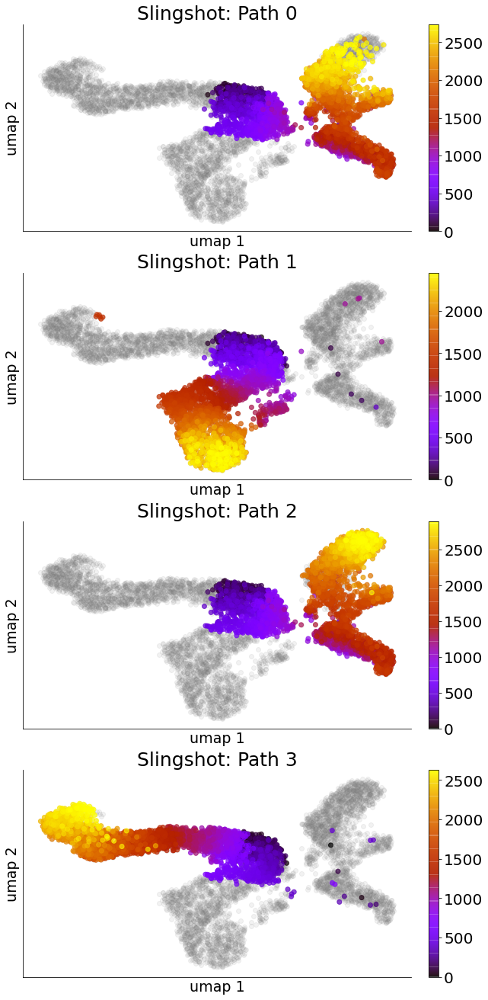

In [637]:
kt_slingshot = slingshot_visual(adata, results, figsize=(10,23), save_as = None)